In [316]:
import random
import itertools

from matplotlib import pyplot as plt
import networkx as nx
import scipy.stats as sts
from scipy.special import expit
import numpy as np

## Local analysis

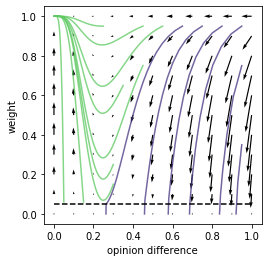

In [317]:
alpha = 0.03
beta = 0.3
gamma = 4

cmap = plt.cm.viridis  # good for color blindness

# Plot traces of how opinion and weight change over time
for opinion, weight in [
    [0.25, 0.95], [0.45, 0.95], [0.55, 0.95], [0.65, 0.95], [0.75, 0.95],
    [0.85, 0.95], [0.95, 0.95], [0.35, 0.65], [0.45, 0.75], [0.95, 0.75],
    [0.95, 0.35], [0.3, 0.25], [0.3, 0.15], [0.15, 0.06], [0.05, 0.06]
]:
    ow = [[opinion, 0.0, weight]]
    for i in range(100):
        delta_o = alpha * ow[-1][2] * (ow[-1][1] - ow[-1][0])
        delta_w = (
            beta * ow[-1][2] * (1-ow[-1][2]) *
            (1-gamma*abs(ow[-1][1] - ow[-1][0])))
        new_weight = ow[-1][2] + delta_w
        if new_weight < 0.05:
            new_weight = 0
        ow.append([ow[-1][0] + delta_o, ow[-1][1] - delta_o, new_weight])
    plt.plot(
        [row[0] - row[1] for row in ow],
        [row[2] for row in ow],
        color=(cmap(0.15) if ow[-1][2] == 0 else cmap(0.75)),
        alpha=0.75)

# Plot vector field
opinion = np.linspace(0, 1, 11)  # the difference in opinion, |o_i - o_j|
weight = np.linspace(0, 1, 11)   # the edge weight, w_ij
ow_grid = np.meshgrid(opinion, weight)
delta_o_grid = -2*alpha * ow_grid[1] * ow_grid[0]
delta_w_grid = beta * ow_grid[1] * (1-ow_grid[1]) * (1 - gamma * ow_grid[0])
plt.quiver(ow_grid[0], ow_grid[1], delta_o_grid, delta_w_grid)

# Annotate plot
plt.xlabel('opinion difference')
plt.ylabel('weight')
plt.plot([0, 1], [0.05, 0.05], 'k--')
plt.axis('square')
plt.show()
plt.show()

In [369]:
class OpinionNetworkSimulation:
    def __init__(
        self, num_ppl,
        open_mind=0.03, easy_going=0.3, stubborn=4,
        persuas=-1, self_conv=-1
    ):
        '''
        Social network simulation with dynamic opinions, persuasiveness,
        and self-research. Parameters are mean numbers that will initialize
        individual people's parameters in `self.init_network()`.
        
        Parameters
        ----------
        num_ppl: int
            Number of people (nodes) in the Watts-Strogatz small world network
            
        open_mind: float [0, 1], optional
            (alpha) Open-mindedness (alpha) indicating how fast nodes adjust their opinion to
            match the neighbor's opinions in an interaction.
            
        easy_going: float [0, 1], optional
            (beta) Easy-goingness indicating how fast their relationship can strengthen or
            degrade over interations.
        
        stubborn: float (0, inf), optional
            (gamma) Lack of ability to separate relationship and opinion. Higher gamma
            will lead to easier degradation of relationship when opinions differ.
            
        persuas: float [0, 1], optional
            (nu) Persuasiveness of a person as a speaker, contributes to how strong the opinion
            of the listener is changed. Ignored if `persuas == -1`
            
        self_conv: float [0, 1], optional
            (eta) Ability to convince oneself from self-research. With a probability, one
            would choose not to listen and do some (confirmation biased) online research instead.
            Ignored if `self_conv == -1`
        '''
        
        # configure class-wide globals
        self.ST_DEV = 0.05  # standard deviation of the initialization distributions
        self.RES_CHANCE = 0.1  # chance of researching as a fraction of interaction strength
        self.RES_OPIN_SWAY = 8e-4  # weight for opinion sway due to self-research
        
        self.traits = {}
        self.traits['open_mind'] = open_mind
        self.traits['easy_going'] = easy_going
        self.traits['stubborn'] = stubborn
        
        if persuas != -1:
            self.traits['persuas'] = persuas
        if self_conv != -1:
            self.traits['self_conv'] = self_conv
        
        self.num_ppl = num_ppl
        self.init_network()
        
    def init_network(self):
        '''
        Initialize the Watts-Strogatz small world network with given parameters.
        For each parameter describing the nodes, a node will receive a value
        sampled from a truncated normal distribution with indicated mean
        and standard deviation = `self.ST_DEV`.
        '''
        
        self.network = nx.watts_strogatz_graph(self.num_ppl, 5, 0.5)
        for edge in self.network.edges:
            self.network.edges[edge]['weight'] = 0.5
        
        for node in self.network.nodes:
            self.network.nodes[node]['opinion'] = random.randint(0, 1)
            for trait in self.traits.keys():
                mean = self.traits[trait]
                low_lim = (0 - mean) / self.ST_DEV
                up_lim = (1 + self.network.nodes[node]['easy_going']) if trait == 'stubborn' else (1 - mean) / self.ST_DEV

                self.network.nodes[node][trait] = sts.truncnorm(
                        a=low_lim, b=up_lim, loc=mean, scale=self.ST_DEV).rvs()
        
        self.layout = nx.spring_layout(self.network)  # visual output
        self.step = 0        

    def update(self):
        '''
        Update the opinion states of a randomly chosen interacting couple.
        '''
        
        if random.uniform(0, 1) < 0.01:  # create a new edge
            nodes = list(self.network.nodes)
            while True:
                new_edge = random.sample(nodes, 2)
                if new_edge not in self.network.edges:
                    break
            self.network.add_edge(new_edge[0], new_edge[1], weight=0.5)
            
        else:  # update opinions and relationship of two interacting people
            edge = random.choice(list(self.network.edges))
            weight = self.network.edges[edge]['weight']
            opinions = [self.network.nodes[n]['opinion'] for n in edge]
            avg_easy_going = 0
            avg_stubborn = 0
            
            # update opinions
            for i in [0, 1]:
                open_mind = self.network.nodes[edge[i]]['open_mind']
                if 'persuas' in self.traits:
                    persuas_neigh = self.network.nodes[edge[1-i]]['persuas']  # how persuasive is the neighbor
                    infl_coef = 0.5*open_mind  + 0.5*(persuas_neigh - 0.5)  # average influence coefficient
                    infl_coef = min(1, max(0, infl_coef))  # constrain to [0, 1]
                else:
                    infl_coef = open_mind
                
                self.network.nodes[edge[i]]['opinion'] = (
                    opinions[i] + infl_coef * weight * (opinions[1-i] - opinions[i]))
                
                avg_easy_going += self.network.nodes[edge[i]]['easy_going']
                avg_stubborn += self.network.nodes[edge[i]]['stubborn']
            
            # update relationship strength
            self.network.edges[edge]['weight'] = (
                weight + avg_easy_going * weight * (1-weight) *
                (1 - avg_stubborn * abs(opinions[0] - opinions[1])))
            
            # update opinion based on self-research
            # usually, if had a good conversation with another person,
            # we would more likely do more research at home
            if 'self_conv' in self.traits:
                for i in [0, 1]:
                    # are we gonna do self-research?
                    if random.uniform(0, 1) < self.network.edges[edge]['weight'] * self.RES_CHANCE:
                        # we are more likely to research what suits our opinion
                        bias = sts.rv_discrete(values=[(-1, 1), (1 - opinions[i], opinions[i])]).rvs()  # bias direction
                        sway = self.network.nodes[edge[i]]['self_conv'] * bias  # how much opinion changes
                        upd_opinion = opinions[i] + self.RES_OPIN_SWAY * sway  # updated opinion
                        
                        upd_opinion = min(1, max(0, upd_opinion))  # constrain to [0, 1]
                        self.network.nodes[edge[i]]['opinion'] = upd_opinion
            
            # remove weak connections
            if self.network.edges[edge]['weight'] < 0.05:
                self.network.remove_edge(*edge)
        
        self.step += 1
        
    def observe(self):
        '''
        Visualize a single opinion state of the network with color coding.
        '''
        
        self.layout = nx.spring_layout(self.network, pos=self.layout, iterations=5)
        nx.draw(
            self.network, pos=self.layout, with_labels=True,
            node_color=[self.network.nodes[i]['opinion'] for i in self.network.nodes],
            edge_color=[self.network.edges[i, j]['weight'] for i, j in self.network.edges],
            edge_cmap=plt.cm.binary, edge_vmin=0, edge_vmax=1,
            alpha=0.7, vmin=0, vmax=1)
        plt.title('Step: ' + str(self.step))
        
    def observe_frames(self, num_frames=10, frame_step=1000):
        '''
        Visualize the observation method over multiple frames.
        
        Parameters
        ----------
        num_frames: int, optional
            Number of observations to show
            
        frame_step: int, optional
            How many update steps between each frame
        '''
        
        # display gradient bar
        gradient = np.linspace(0, 1, 256)
        gradient = np.vstack((gradient, gradient))
        
        plt.figure(figsize=(16, 0.2), dpi=330)
        plt.title('opinion range')
        plt.imshow(gradient, aspect='auto', cmap=plt.cm.viridis)
        plt.yticks([])
        positions, labels = [0, 64, 128, 192, 256], [0, 0.25, 0.5, 0.75, 1]
        plt.xticks(positions, labels)
        plt.show()
         
        num_cols = 3
        num_rows = int(np.ceil((num_frames + 1) / num_cols))
        plt.figure(figsize=(6 * num_rows, 16), dpi=330)
        
        plt.subplot(num_rows, num_cols, 1)
        self.observe()
        for i in range(num_frames):
            for _ in range(frame_step):
                self.update()
                
            plt.subplot(num_rows, num_cols, i + 2)
            self.observe()
        plt.show()

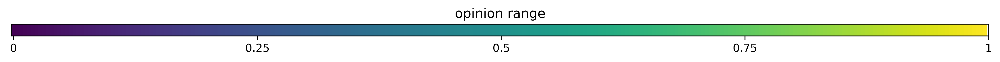

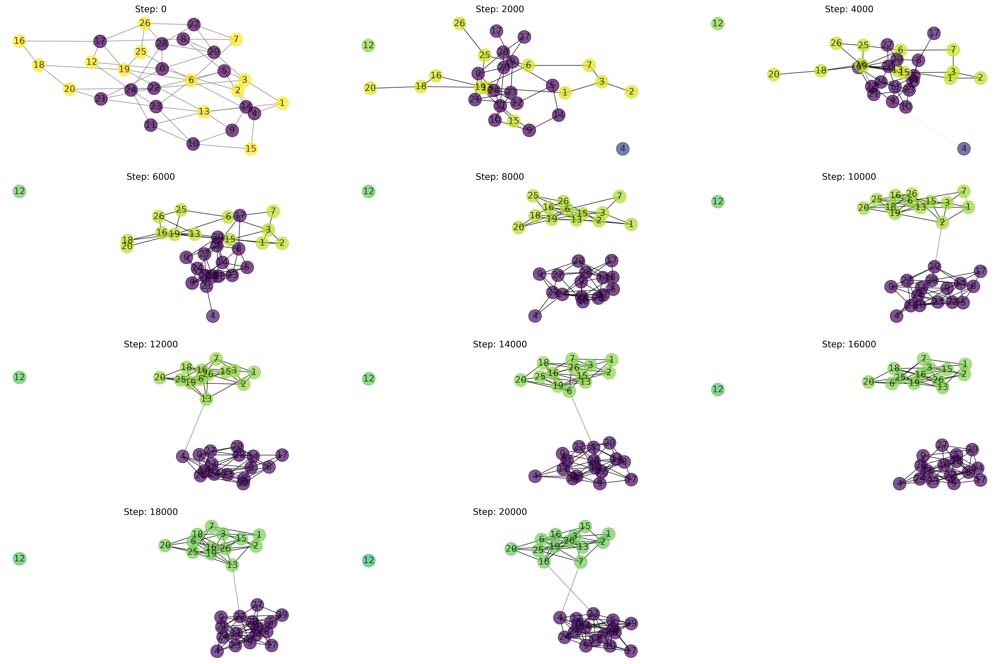

In [377]:
# original model
netwk = OpinionNetworkSimulation(num_ppl=30)
netwk.observe_frames(num_frames=10, frame_step=2000)

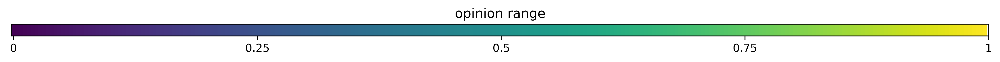

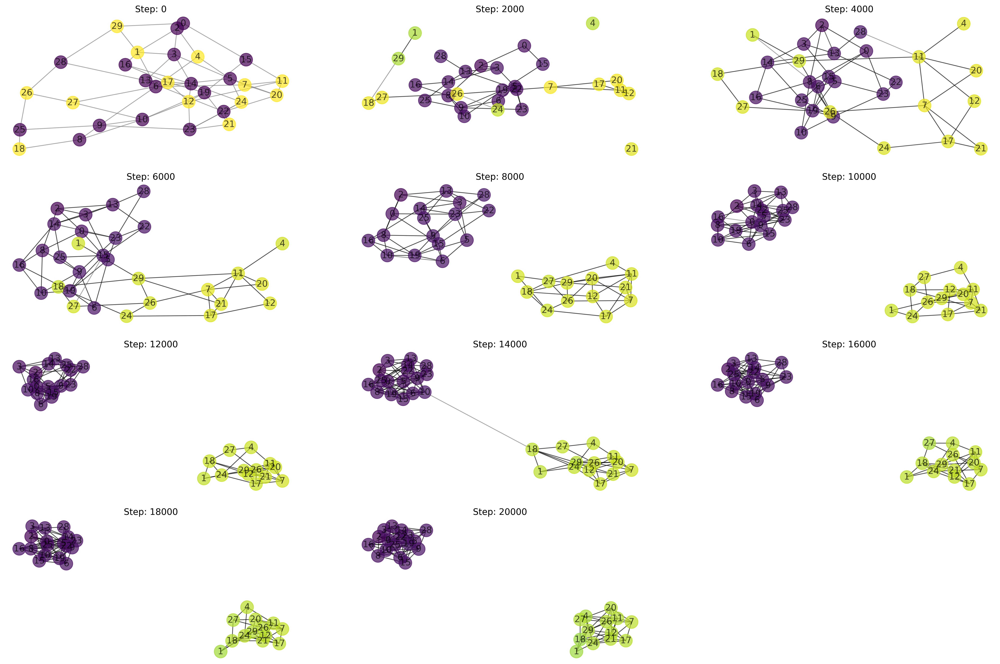

In [379]:
# everyone is a bit of a self-researcher
netwk = OpinionNetworkSimulation(num_ppl=30, self_conv=0.01)
netwk.observe_frames(num_frames=10, frame_step=2000)

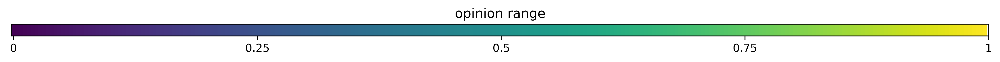

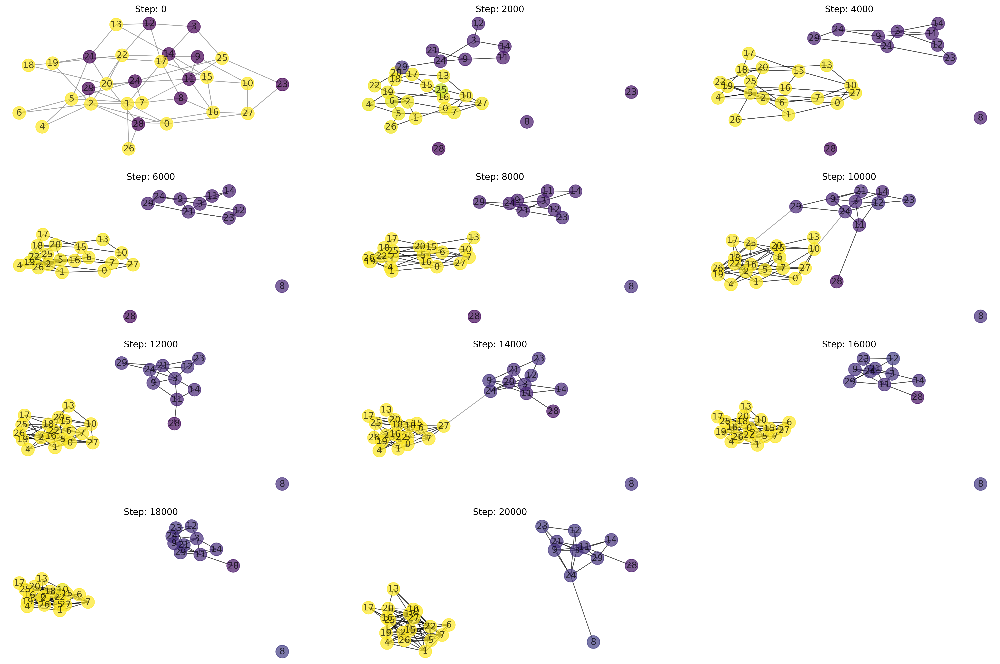

In [372]:
# everyone is intermediate self-researchery
netwk = OpinionNetworkSimulation(num_ppl=30, self_conv=0.5)
netwk.observe_frames(num_frames=10, frame_step=2000)

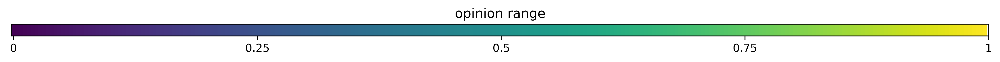

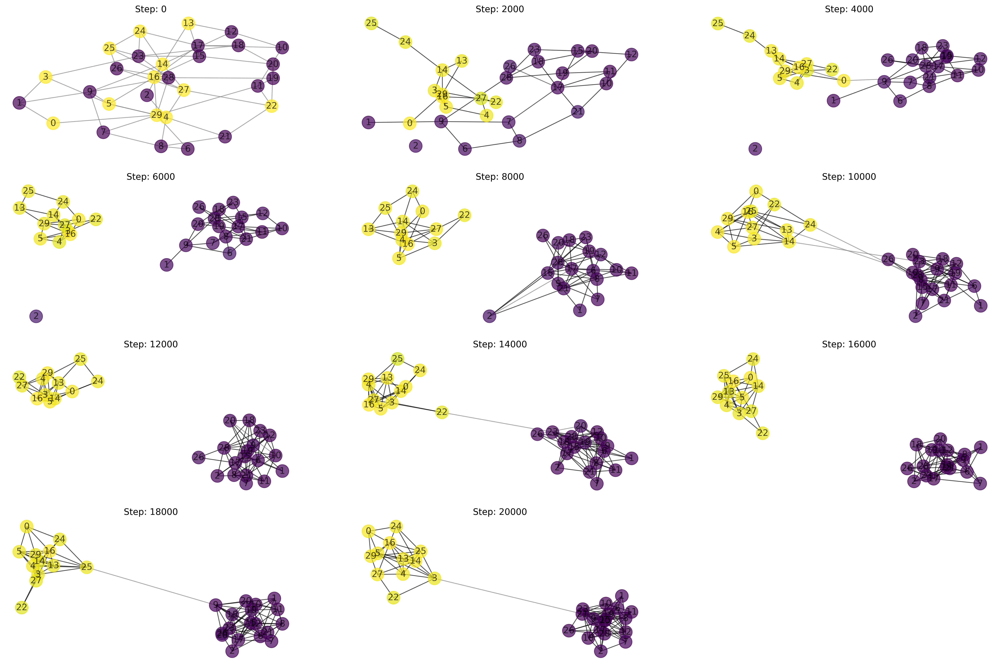

In [373]:
# everyone is highly self-researchery
netwk = OpinionNetworkSimulation(num_ppl=30, self_conv=0.9)
netwk.observe_frames(num_frames=10, frame_step=2000)

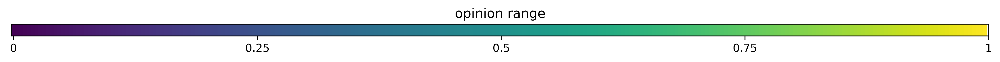

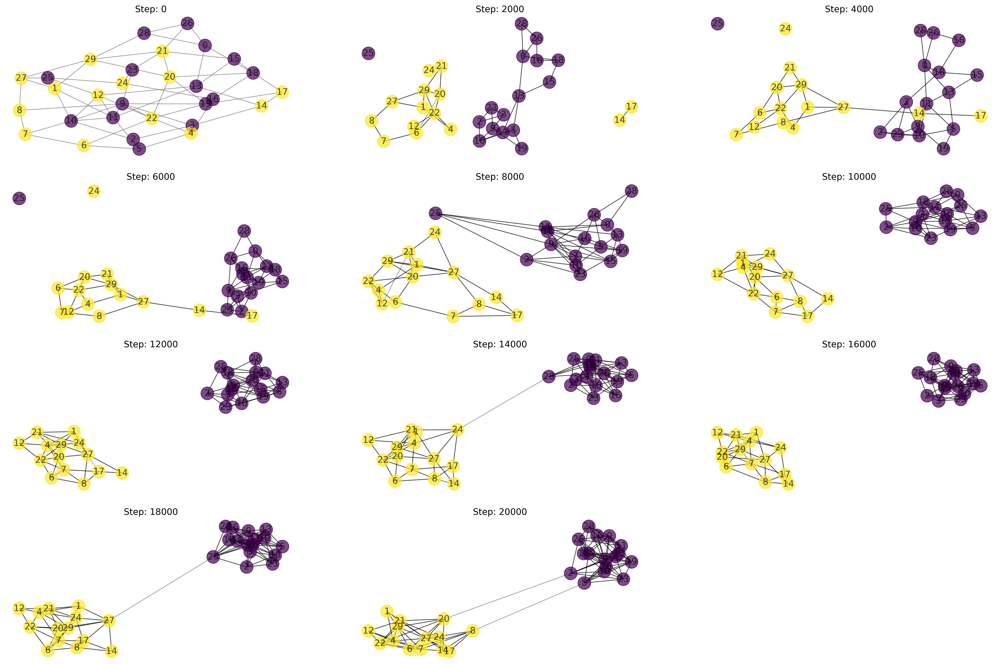

In [374]:
netwk = OpinionNetworkSimulation(num_ppl=30, persuas=0.1)
netwk.observe_frames(num_frames=10, frame_step=2000)

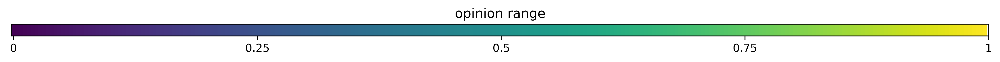

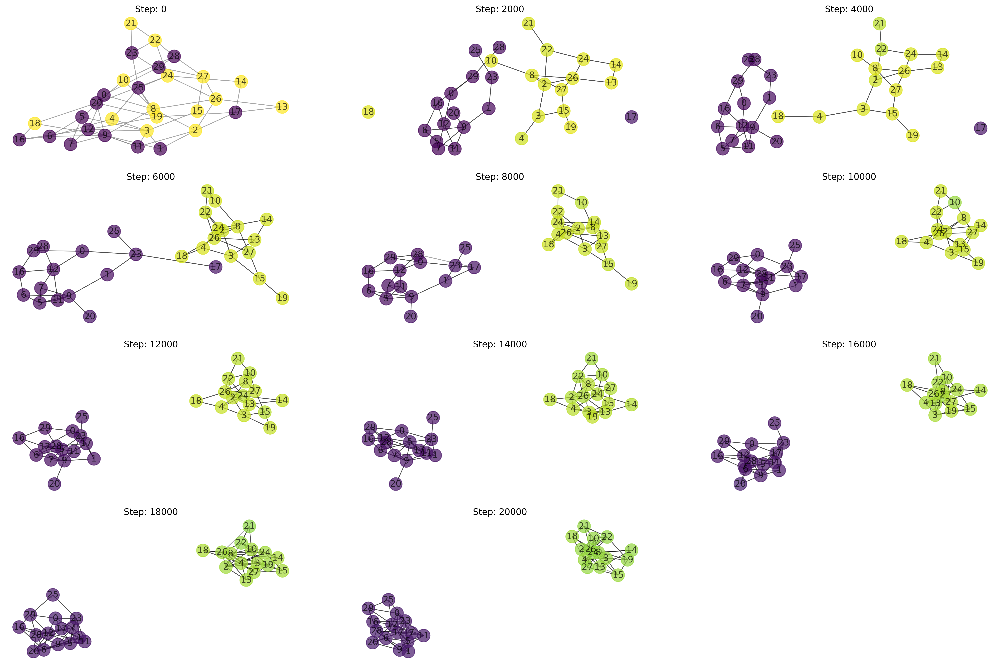

In [375]:
netwk = OpinionNetworkSimulation(num_ppl=30, persuas=0.5)
netwk.observe_frames(num_frames=10, frame_step=2000)

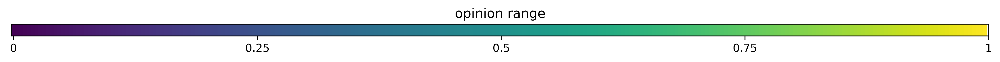

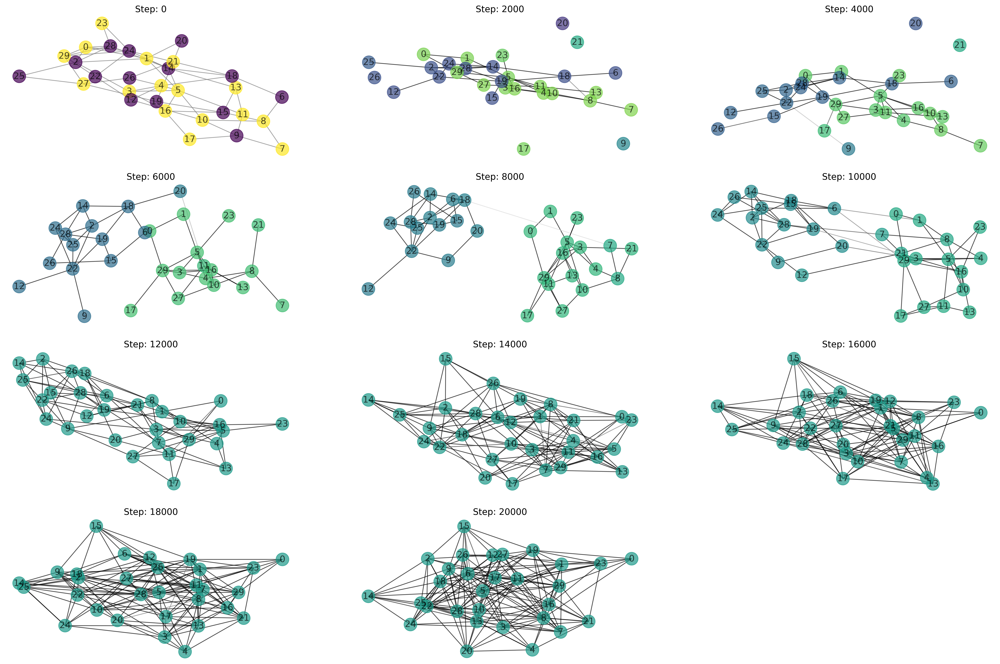

In [376]:
netwk = OpinionNetworkSimulation(num_ppl=30, persuas=0.9)
netwk.observe_frames(num_frames=10, frame_step=2000)